## NeurIPS heads replication (UKBB)

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

  import numpy.matlib as npm

  autumn = cm.get_cmap('autumn', 256)

  winter = cm.get_cmap('winter_r', 256)



In [3]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run) 

<module 'sim.sim_run' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/sim/sim_run.py'>

#### Check job specs

In [4]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 6.4%
RAM Usage: 3.1%
Available RAM: 1.4T
Total RAM: 1.5T
52.4G


In [5]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB


In [6]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

### Attention heads

In [7]:
from models.smt import SharedSelfAttentionModel, SharedSelfAttentionCLSModel

from data.data_load import load_transcriptome, load_connectome, load_coords, load_network_labels
from data.data_viz import plot_connectome, plot_transcriptome
from data.data_utils import expand_X_symmetric, expand_Y_symmetric

from data.data_utils import RegionPairDataset
from torch.utils.data import Subset

In [8]:
# Load data
print("Loading data...")
X, valid_genes = load_transcriptome(parcellation='S456', hemisphere='both', omit_subcortical=False, sort_genes='refgenome', impute_strategy='mirror_interpolate', return_valid_genes=True)
Y = load_connectome(dataset='UKBB', parcellation='S456', hemisphere='both', omit_subcortical=False)
coords = load_coords(parcellation='S456', hemisphere='both', omit_subcortical=False)
labels, network_labels = load_network_labels(parcellation='S456', hemisphere='both', omit_subcortical=False)

# Find rows that are not all NaN - necessary for gene expression data with unsampled regions
valid_indices = ~np.isnan(X).all(axis=1)

# Create index map so we know true indices of valid data
valid_indices_values = np.where(valid_indices)[0]
valid2true_mapping = dict(enumerate(valid_indices_values))

# Subset all data using valid indices
X_valid = X[valid_indices]
Y_valid = Y[valid_indices][:, valid_indices]
coords_valid = coords[valid_indices]
labels = [labels[i] for i in range(len(labels)) if valid_indices[i]]
network_labels = network_labels[valid_indices]

Loading data...


Build network dataloaders

In [9]:
# Create pairwise datasets for each subnetwork
unique_networks = np.unique(network_labels)

network_datasets = {}
network_dataloaders = {}
print("Creating pairwise datasets and dataloaders for each subnetwork...")

for network in unique_networks:
    # Create mask for current network
    network_mask = network_labels == network
    
    # Subset data for this network
    X_network = X_valid[network_mask]
    Y_network = Y_valid[network_mask][:, network_mask]
    coords_network = coords_valid[network_mask]
    
    # Create mapping from network indices to true indices
    network_indices = np.where(network_mask)[0]
    network2true_mapping = {i: valid2true_mapping[idx] for i, idx in enumerate(network_indices)}
    
    # Create pairwise dataset for this network
    network_datasets[network] = RegionPairDataset(
        X=X_network,
        Y=Y_network,
        coords=coords_network,
        valid2true_mapping=network2true_mapping,
        dataset='UKBB',
        parcellation='S456', 
        valid_genes=valid_genes
    )
    
    # Create dataloader for this network
    network_dataloaders[network] = DataLoader(
        network_datasets[network],
        batch_size=512,
        shuffle=False,
        num_workers=4,
        pin_memory=True
    )
    print(f"Network {network}: {len(network_datasets[network])} region pairs")

Creating pairwise datasets and dataloaders for each subnetwork...
Network Cerebellum: 72 region pairs
Network Cont: 2652 region pairs
Network Default: 8190 region pairs
Network DorsAttn: 2070 region pairs
Network Limbic: 650 region pairs
Network SalVentAttn: 2162 region pairs
Network SomMot: 5852 region pairs
Network Subcortical: 2070 region pairs
Network Vis: 3660 region pairs


Build full dataset

In [10]:
# Create full pairwise dataset
print("Creating full pairwise dataset...")

# Create full pairwise dataset
full_dataset = RegionPairDataset(
    X=X_valid,
    Y=Y_valid, 
    coords=coords_valid,
    valid2true_mapping=valid2true_mapping,
    dataset='UKBB',
    parcellation='S456', 
    valid_genes=valid_genes
)

print(f"Full dataset: {len(full_dataset)} region pairs")

# Create full dataloader
full_dataloader = DataLoader(
    full_dataset,
    batch_size=512,
    shuffle=False,
    num_workers=4,
    pin_memory=True
)


Creating full pairwise dataset...
Full dataset: 206570 region pairs


Load in models trained on full UKBB dataset (spin test inputs)

In [11]:
from models.smt import SharedSelfAttentionModel, SharedSelfAttentionCLSModel

# SMT EMBEDDINGS - 3 versions ###
smt_model_v1 = SharedSelfAttentionModel(input_dim=14760, token_encoder_dim=60, d_model=128,
                                          nhead=4, num_layers=4,
                                          deep_hidden_dims=[512, 256, 128], use_alibi=True, transformer_dropout=0.2,
                                          dropout_rate=0.2, learning_rate=0.00009, weight_decay=0.0001,
                                          batch_size=1024, aug_prob=0.3, epochs=110, num_workers=2, prefetch_factor=4)

smt_model_v2 = SharedSelfAttentionModel(input_dim=14760, token_encoder_dim=60, d_model=128,
                                          nhead=4, num_layers=4,
                                          deep_hidden_dims=[512, 256, 128], use_alibi=True, transformer_dropout=0.2,
                                          dropout_rate=0.2, learning_rate=0.00009, weight_decay=0.0001,
                                          batch_size=1024, aug_prob=0.3, epochs=110, num_workers=2, prefetch_factor=4)

# Load weights and prepare models
for i, model in enumerate([smt_model_v1, smt_model_v2], 1):
    model_path = f"/scratch/asr655/neuroinformatics/GeneEx2Conn/models/saved_models/UKBB_smt_full{i}_spin.pt"
    model.load_state_dict(torch.load(model_path))
    model.eval()
    model.to("cuda")
    model.encoder.eval()

  warnings.warn(



Number of learnable parameters in SMT model: 2162315
Number of learnable parameters in SMT model: 2162315


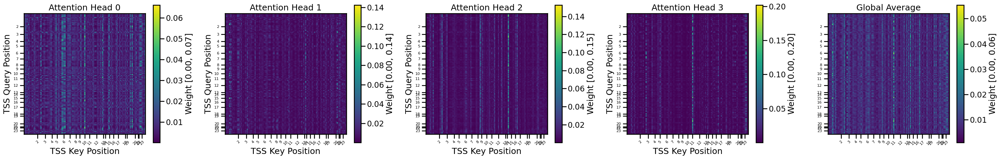

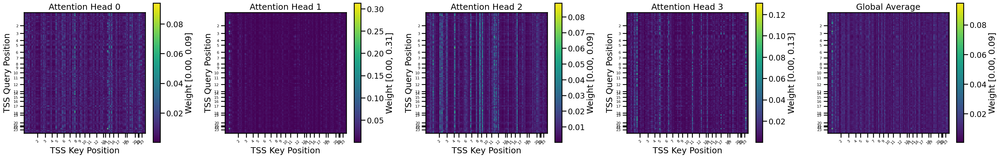

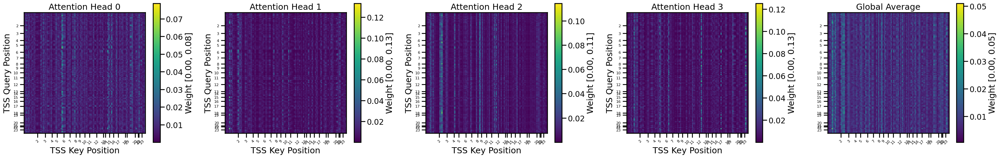

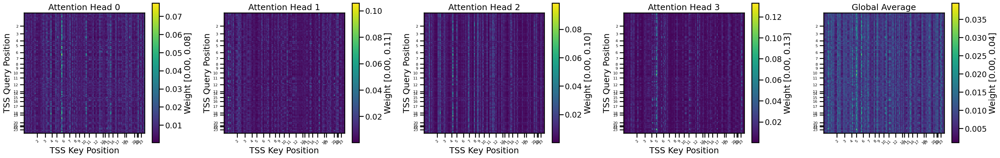

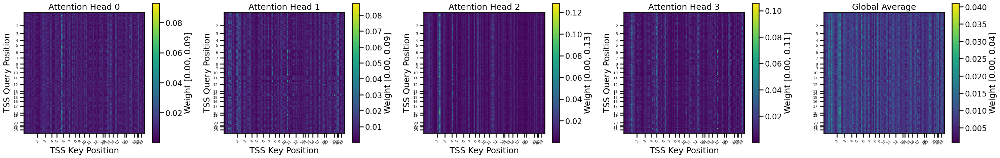

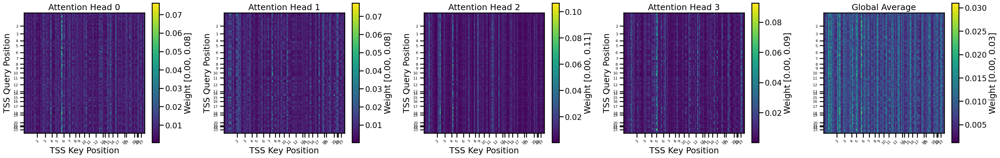

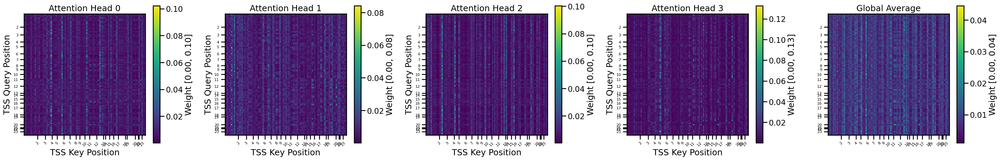

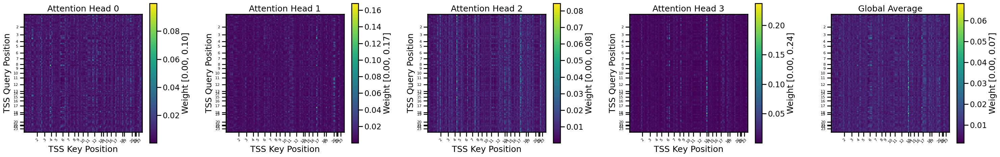

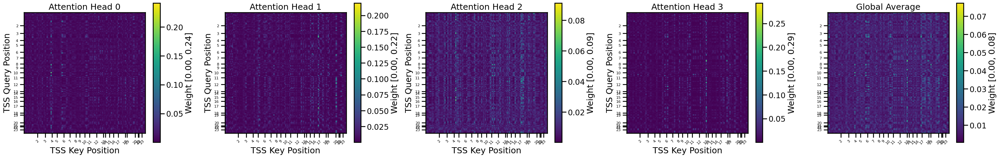

W1006 21:12:39.640000 22591249979200 torch/_dynamo/convert_frame.py:762] [1/8] torch._dynamo hit config.cache_size_limit (8)
W1006 21:12:39.640000 22591249979200 torch/_dynamo/convert_frame.py:762] [1/8]    function: 'forward' (/scratch/asr655/neuroinformatics/GeneEx2Conn/models/smt_utils.py:118)
W1006 21:12:39.640000 22591249979200 torch/_dynamo/convert_frame.py:762] [1/8]    last reason: ___check_obj_id(L['self'].ffn, 22585450016656)              
W1006 21:12:39.640000 22591249979200 torch/_dynamo/convert_frame.py:762] [1/8] To log all recompilation reasons, use TORCH_LOGS="recompiles".
W1006 21:12:39.640000 22591249979200 torch/_dynamo/convert_frame.py:762] [1/8] To diagnose recompilation issues, see https://pytorch.org/docs/main/torch.compiler_troubleshooting.html.


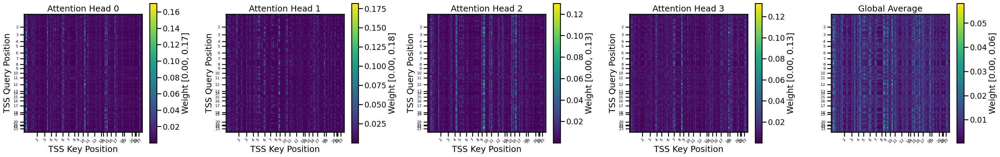

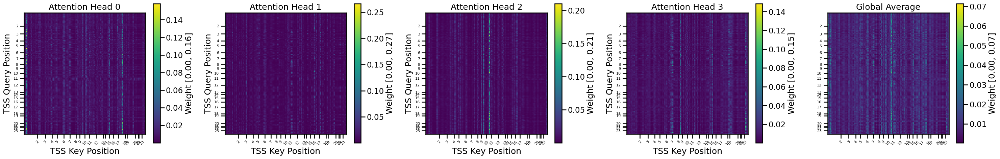

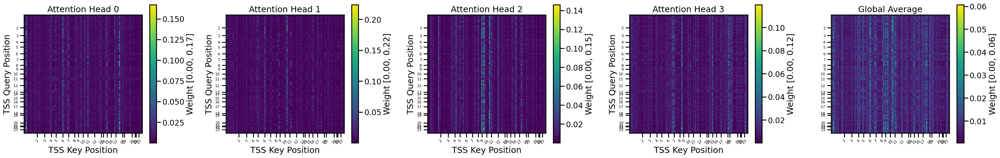

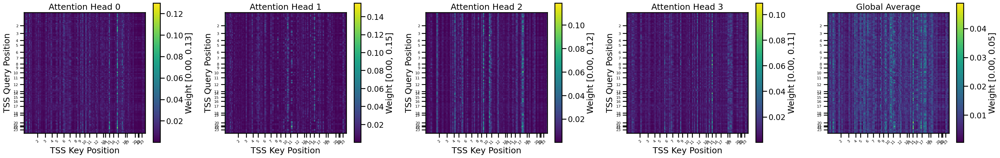

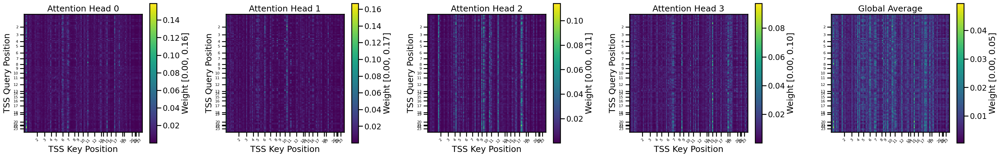

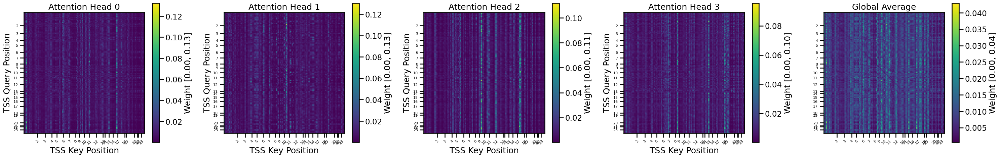

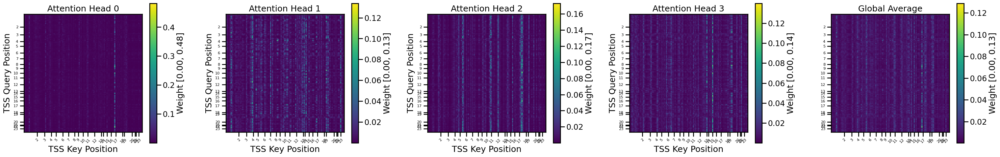

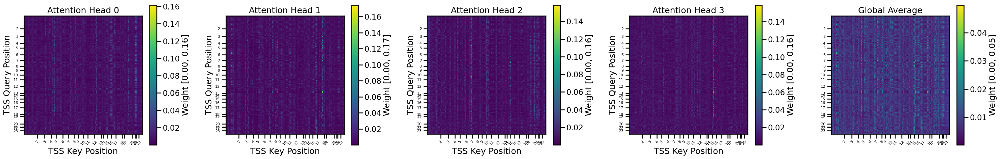

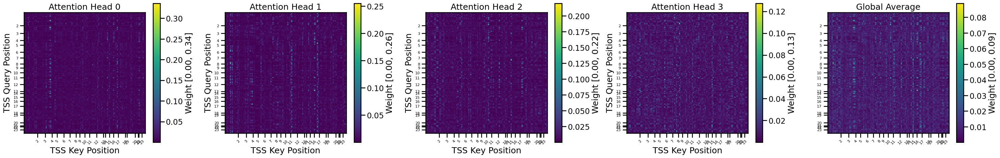

In [12]:
# Get predictions and attention weights for all base SMT models across all subnetworks
avg_attn_smt_dict_v1 = {}
avg_attn_smt_dict_v2 = {}
avg_attn_smt_dict_v3 = {}
keys = ['Vis', 'SomMot', 'DorsAttn', 'SalVentAttn', 'Cont', 'Default', 'Limbic', 'Subcortical', 'Cerebellum']

# Collect for model v1
for subnetwork in keys:
    print(f"Collecting attention weights for base SMT model v1 on {subnetwork} system data...")
    predictions_v1, targets_v1, avg_attn = smt_model_v1.predict(
        network_dataloaders[subnetwork],
        collect_attn=True,
        #save_attn_path=f'smt_v1_{subnetwork}_avg_attn.npy'
    )
    avg_attn_smt_dict_v1[subnetwork] = avg_attn

# Collect for model v2  
for subnetwork in keys:
    print(f"Collecting attention weights for base SMT model v2 on {subnetwork} system data...")
    predictions_v2, targets_v2, avg_attn = smt_model_v2.predict(
        network_dataloaders[subnetwork],
        collect_attn=True,
        #save_attn_path=f'smt_v2_{subnetwork}_avg_attn.npy'
    )
    avg_attn_smt_dict_v2[subnetwork] = avg_attn


In [13]:
from models.smt_utils import plot_global_head_attention, plot_subnetwork_token_attention, plot_subnetwork_expression_correlation

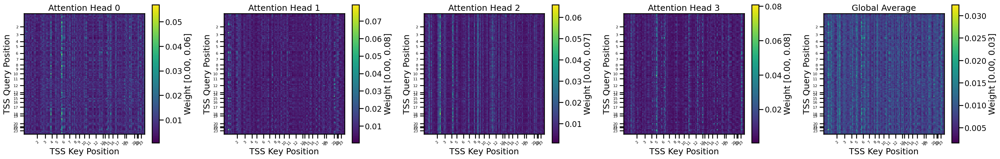

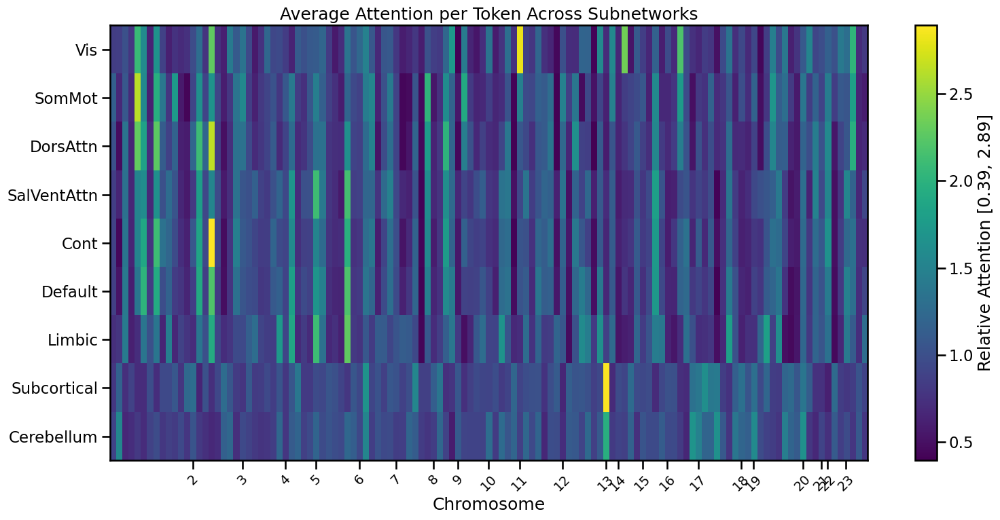

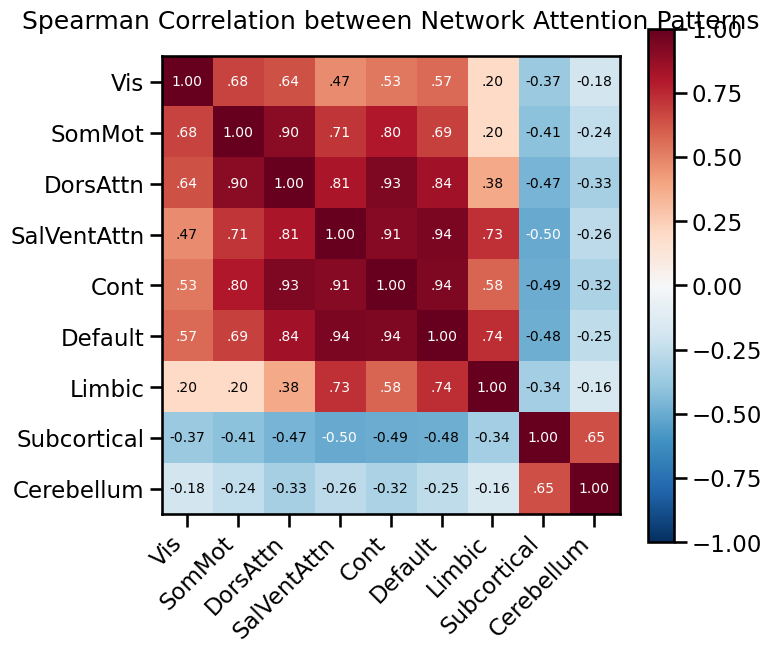

array([[0.84726393, 0.85743415, 1.00116348, ..., 2.03191662, 0.70400226,
        0.81102908],
       [1.15832007, 0.68089932, 1.07721961, ..., 1.81829464, 0.64892846,
        0.59310734],
       [1.01517773, 0.46467972, 1.35034919, ..., 1.97437966, 0.65278262,
        0.70201224],
       ...,
       [0.73022217, 0.78382874, 1.41775835, ..., 1.11003625, 0.72239923,
        1.28727424],
       [0.80067706, 1.18124115, 0.7347784 , ..., 0.84934527, 1.04718184,
        0.90192991],
       [0.9012059 , 1.54784298, 0.67410034, ..., 0.78599787, 1.09131384,
        0.79411876]])

In [14]:
plot_global_head_attention(avg_attn_smt_dict_v1, use_chrom_labels=True, token_encoder_dim=60)
plot_subnetwork_token_attention(avg_attn_smt_dict_v1, use_chrom_labels=True, token_encoder_dim=60)

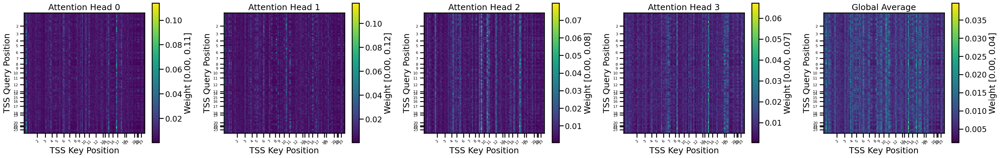

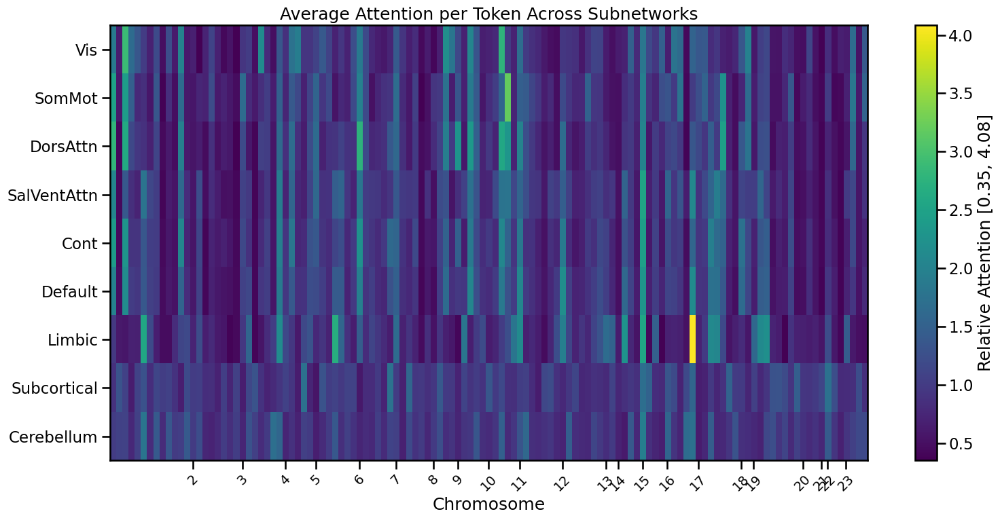

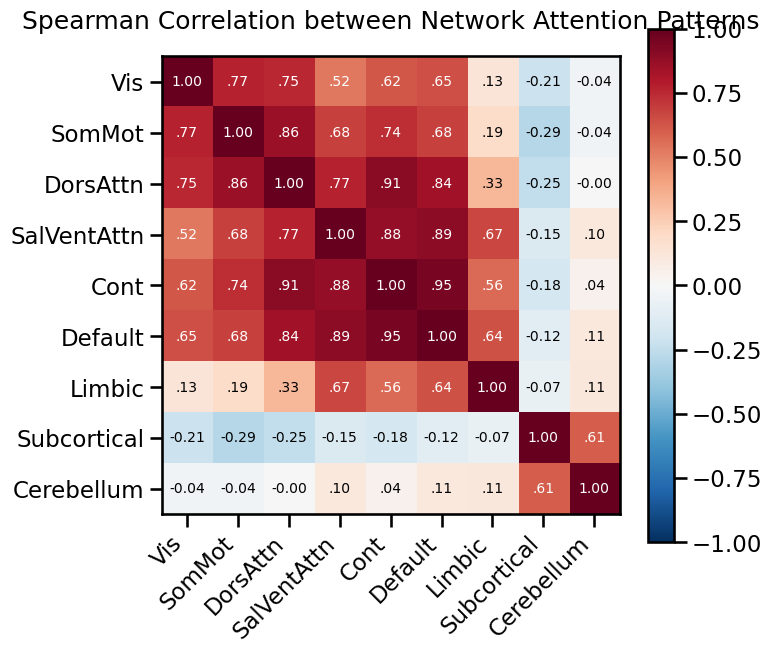

array([[1.88215315, 0.63420099, 2.89938498, ..., 1.67192614, 0.5304656 ,
        1.39251494],
       [2.48325968, 0.58988988, 2.41404128, ..., 1.82676125, 0.61044484,
        1.54456198],
       [2.81294966, 0.41640285, 2.62290239, ..., 1.60765624, 0.5591774 ,
        0.93835992],
       ...,
       [0.96880984, 0.61144376, 0.57670313, ..., 0.60529101, 0.50918806,
        0.48517179],
       [0.87636638, 1.30514324, 1.06961358, ..., 0.85099256, 1.23052466,
        0.85650545],
       [1.01046634, 1.07722664, 1.09438872, ..., 1.06272781, 1.18077254,
        1.17014265]])

In [17]:
plot_global_head_attention(avg_attn_smt_dict_v2, use_chrom_labels=True, token_encoder_dim=60)
plot_subnetwork_token_attention(avg_attn_smt_dict_v2, use_chrom_labels=True, token_encoder_dim=60)

  warnings.warn(



Number of learnable parameters in SMT w/ CLS model: 2173067
Number of learnable parameters in SMT w/ CLS model: 2173067


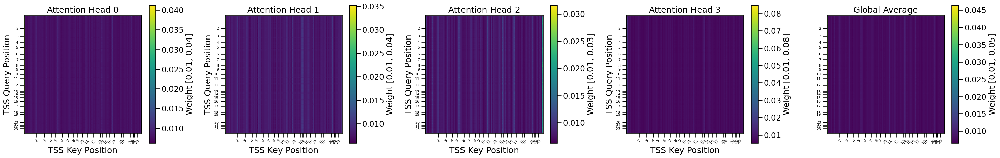

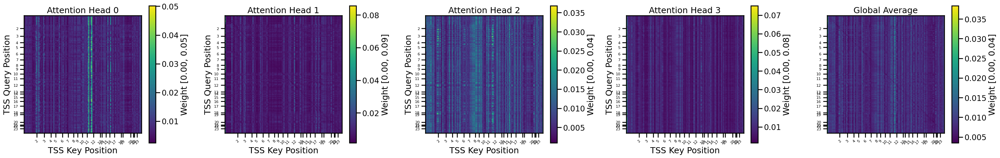

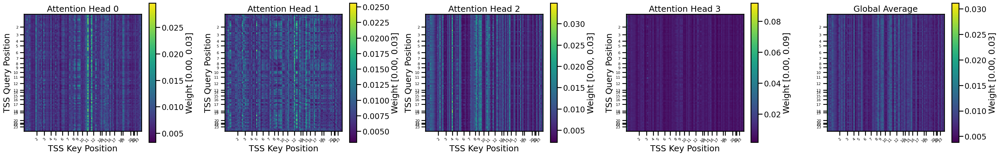

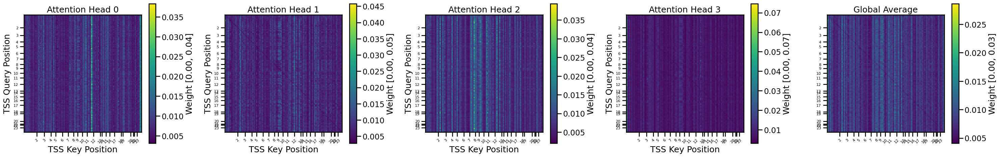

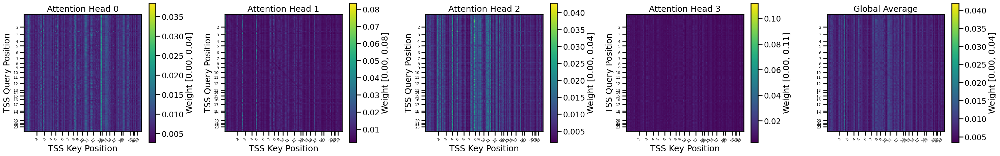

...

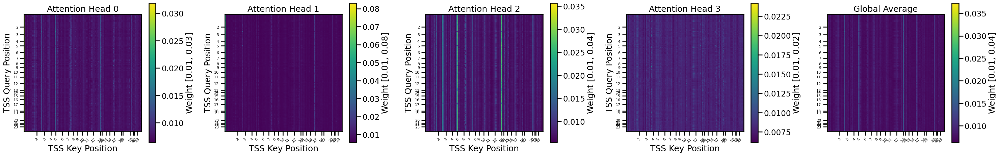

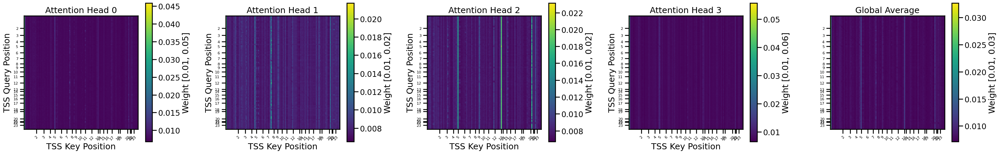

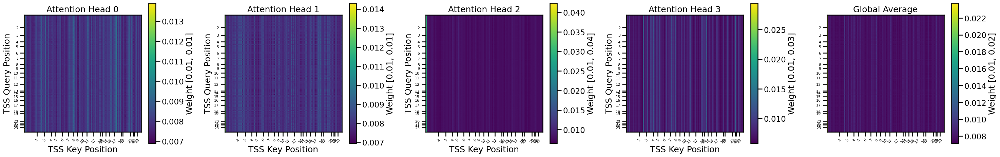

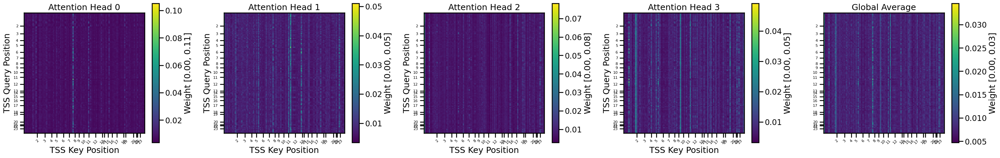

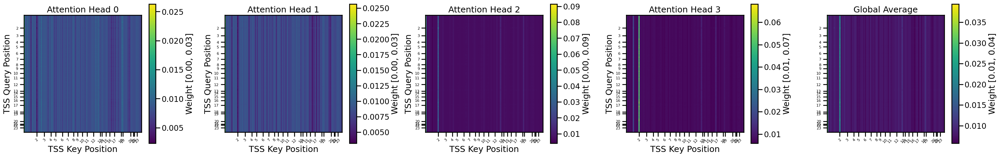

In [18]:
# SMT CLS EMBEDDINGS - 3 versions ###
smt_cls_model_v1 = SharedSelfAttentionCLSModel(input_dim=14760, token_encoder_dim=60, d_model=128,
                                          nhead=4, num_layers=4,
                                          deep_hidden_dims=[512, 256, 128], use_alibi=True, transformer_dropout=0.2,
                                          dropout_rate=0.2, learning_rate=0.00009, weight_decay=0.0001,
                                          batch_size=1024, aug_prob=0.0, epochs=110, num_workers=2, prefetch_factor=4,
                                          cls_init='spatial_learned')

smt_cls_model_v2 = SharedSelfAttentionCLSModel(input_dim=14760, token_encoder_dim=60, d_model=128,
                                          nhead=4, num_layers=4,
                                          deep_hidden_dims=[512, 256, 128], use_alibi=True, transformer_dropout=0.2,
                                          dropout_rate=0.2, learning_rate=0.00009, weight_decay=0.0001,
                                          batch_size=1024, aug_prob=0.0, epochs=110, num_workers=2, prefetch_factor=4,
                                          cls_init='spatial_learned')

# Load weights and prepare models
for i, model in enumerate([smt_cls_model_v1, smt_cls_model_v2], 1):
    model_path = f"/scratch/asr655/neuroinformatics/GeneEx2Conn/models/saved_models/UKBB_smtcls_full{i}_spin.pt"
    model.load_state_dict(torch.load(model_path))
    model.eval()
    model.to("cuda")
    model.encoder.eval()

# Get predictions and attention weights for all CLS SMT models across all subnetworks
avg_attn_smtcls_dict_v1 = {}
avg_attn_smtcls_dict_v2 = {}
keys = ['Vis', 'SomMot', 'DorsAttn', 'SalVentAttn', 'Cont', 'Default', 'Limbic', 'Subcortical', 'Cerebellum']

# Collect for CLS model v1
for subnetwork in keys:
    print(f"Collecting attention weights for CLS SMT model v1 on {subnetwork} system data...")
    predictions_v1, targets_v1, avg_attn = smt_cls_model_v1.predict(
        network_dataloaders[subnetwork],
        collect_attn=True,
        #save_attn_path=f'smt_cls_v1_{subnetwork}_avg_attn.npy'
    )
    avg_attn_smtcls_dict_v1[subnetwork] = avg_attn

# Collect for CLS model v2  
for subnetwork in keys:
    print(f"Collecting attention weights for CLS SMT model v2 on {subnetwork} system data...")
    predictions_v2, targets_v2, avg_attn = smt_cls_model_v2.predict(
        network_dataloaders[subnetwork],
        collect_attn=True,
        #save_attn_path=f'smt_cls_v2_{subnetwork}_avg_attn.npy'
    )
    avg_attn_smtcls_dict_v2[subnetwork] = avg_attn

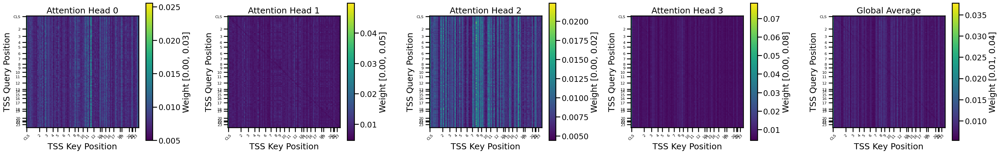

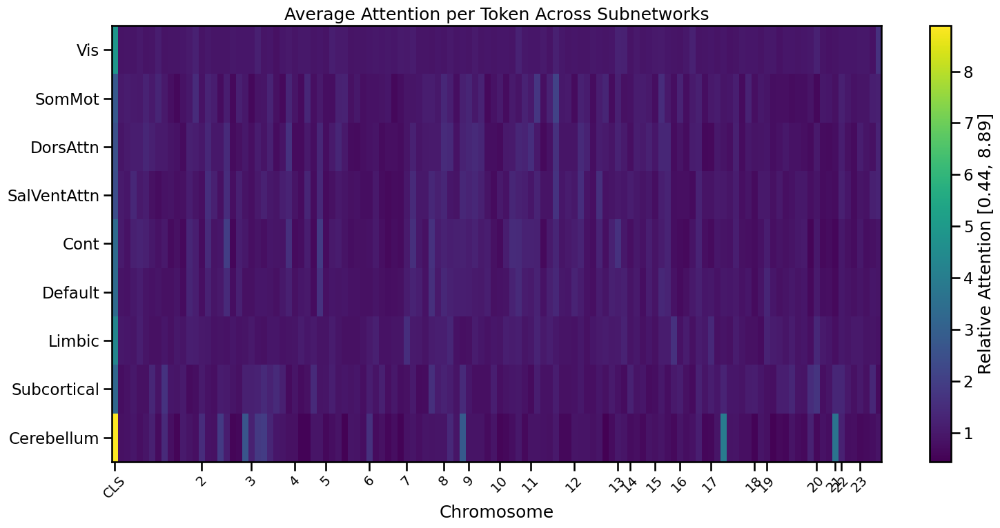

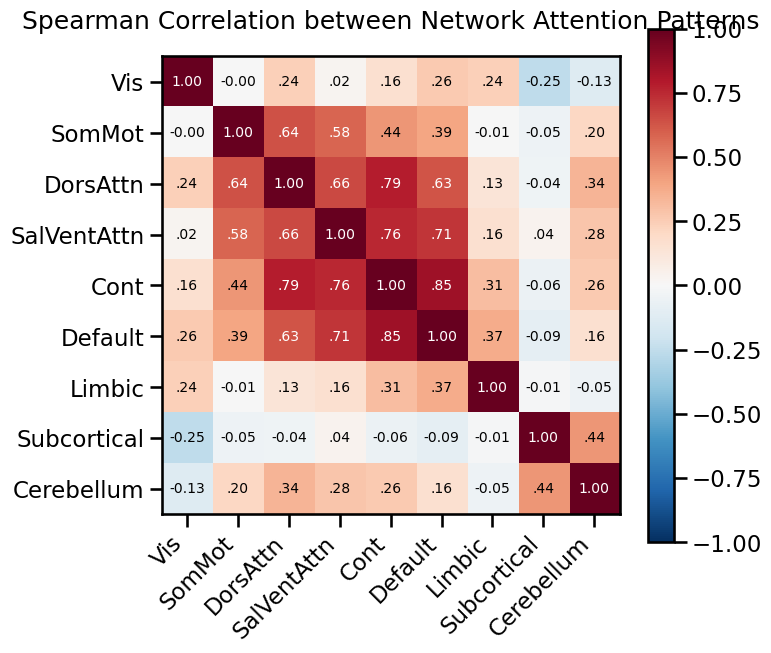

array([[4.85989952, 0.89942265, 0.92045748, ..., 0.98483711, 0.84802872,
        1.64428663],
       [2.79164481, 1.01921356, 1.0847733 , ..., 0.92370379, 1.16254246,
        1.19096386],
       [2.54358864, 0.90967   , 1.05594409, ..., 0.90308249, 0.8074398 ,
        1.26857042],
       ...,
       [4.27625179, 0.96994382, 0.94655049, ..., 0.87457973, 0.91660941,
        0.83487916],
       [3.24781394, 0.76515865, 0.84429634, ..., 0.81112373, 1.37523293,
        0.68631518],
       [8.88545322, 0.83103728, 0.85949546, ..., 0.68522036, 0.74913263,
        0.87583172]])

In [19]:
plot_global_head_attention(avg_attn_smtcls_dict_v1, use_chrom_labels=True, token_encoder_dim=60, cls_token=True)
plot_subnetwork_token_attention(avg_attn_smtcls_dict_v1, use_chrom_labels=True, token_encoder_dim=60, cls_token=True)

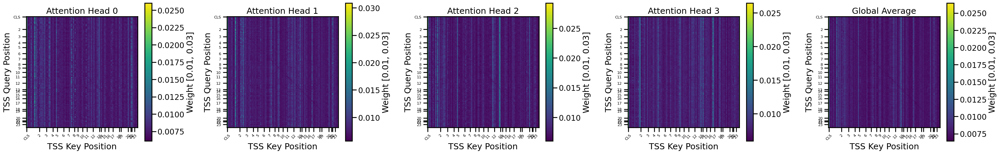

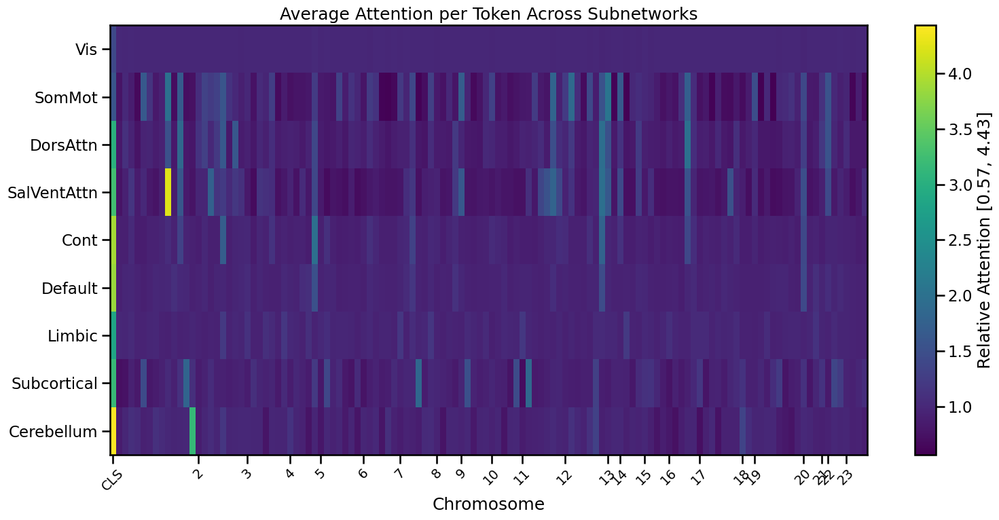

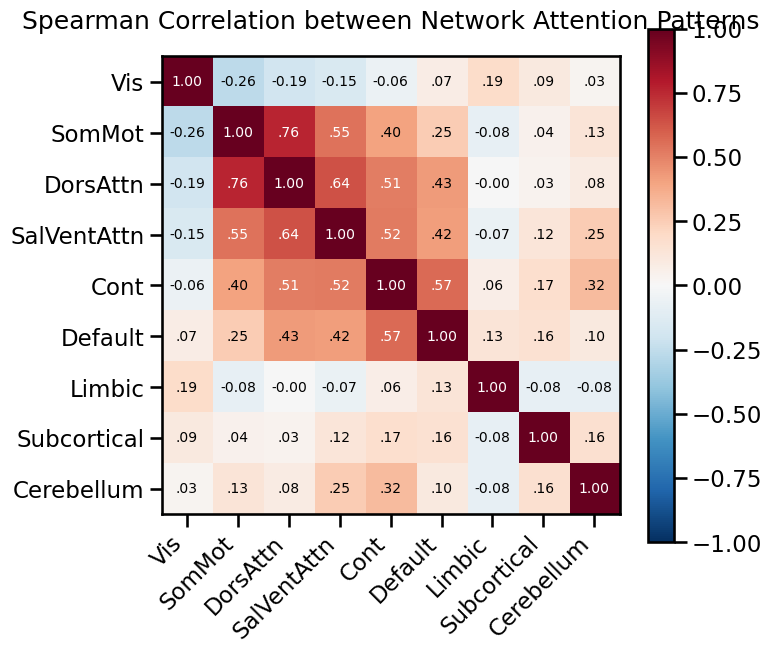

array([[1.42556608, 1.00994182, 1.00347328, ..., 0.98828661, 0.99767262,
        1.00263834],
       [1.58561552, 0.77653337, 1.0079639 , ..., 0.61797178, 0.89456254,
        0.67156279],
       [3.03620553, 0.82659614, 1.10653126, ..., 0.82606596, 0.8321203 ,
        0.83226848],
       ...,
       [2.84196734, 0.99927515, 0.97556245, ..., 0.95627797, 0.93230474,
        0.95633948],
       [3.16746163, 0.73153186, 0.75278646, ..., 0.92610598, 0.97978044,
        1.06817889],
       [4.43364525, 0.85714167, 0.98698527, ..., 0.91831803, 0.93756068,
        0.88142776]])

In [20]:
plot_global_head_attention(avg_attn_smtcls_dict_v2, use_chrom_labels=True, token_encoder_dim=60, cls_token=True)
plot_subnetwork_token_attention(avg_attn_smtcls_dict_v2, use_chrom_labels=True, token_encoder_dim=60, cls_token=True)